In [28]:
import argparse
import os
import glob
import random
import numpy as np
import matplotlib.pyplot as plt

In [29]:
### load data
from data_loader import DataLoader

folder_path = "/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01"
roi_nii_path = os.path.join(folder_path, f'navigation_native_labeled_cluster_sizes.nii.gz')

# nii_files = [
#     'sub-01_ses-01_run-01_task-viewing.nii.gz',
#     'sub-01_ses-01_run-02_task-viewing.nii.gz',
#     'sub-01_ses-01_run-03_task-viewing.nii.gz',
#     'sub-01_ses-01_run-04_task-viewing.nii.gz',
#     'sub-01_ses-01_run-05_task-viewing.nii.gz',
#     'sub-01_ses-01_run-06_task-viewing.nii.gz',
#     'sub-01_ses-01_run-07_task-viewing.nii.gz',
#     'sub-01_ses-01_run-08_task-viewing.nii.gz',
# ]

nii_files = glob.glob(f"{folder_path}/*task-viewing.nii.gz")
nii_files.sort()

loader = DataLoader(voxel_nii_files=nii_files, roi_nii_path=roi_nii_path)

cluster_labels = loader.get_cluster_labels()
print(f"Cluster Labels: {cluster_labels}")

Cluster Labels: [ 120  138  153  163  201  283  595  645  894 3026]


In [30]:
nii_files

['/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-01_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-02_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-03_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-04_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-05_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-06_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-07_task-viewing.nii.gz',
 '/gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-08_task-viewing.nii.gz']

In [31]:
n_prev_states = 2
cluster_id = 595

dataset_file = f"data__cluster-{cluster_id}_prevstates-{n_prev_states}.npy"
save_data = False

try:
    print(f"Try loading dataset from existing file: {dataset_file}")

    with open(dataset_file, 'rb') as f:
        dataset = np.load(f)

    print("Loaded dataset from existing file")

except FileNotFoundError:
    print("No existing file found")
    nii_file_paths = [os.path.join(folder_path, f) for f in nii_files]

    dataset_file = loader.get_state_dataset2(cluster_id=cluster_id, n_prev_states=n_prev_states, 
                                            run_ids=True, do_pca=True)

    print(f"Created dataset of size: {dataset_file.shape}")

    if save_data:
        with open(dataset_file, 'wb') as f:
            np.save(f, dataset)

Try loading dataset from existing file: data__cluster-595_prevstates-2.npy
No existing file found
loading data from /gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-01_task-viewing.nii.gz...
Run 1 - size of data: (173, 595)
loading data from /gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-02_task-viewing.nii.gz...
Run 2 - size of data: (197, 595)
loading data from /gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-03_task-viewing.nii.gz...
Run 3 - size of data: (189, 595)
loading data from /gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-04_task-viewing.nii.gz...
Run 4 - size of data: (243, 595)
loading data from /gpfs/milgram/scratch/turk-browne/elb77/Avatar/derivatives/pipeline3/sub-01/sub-01_ses-01_run-05_task-viewing.nii.gz...
Run 5 - size of data: (192, 595)
loading data from /gpfs/milgram/scratch/turk-br

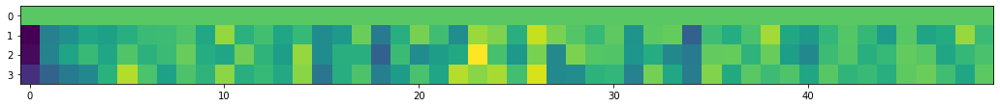

In [32]:
plt.figure(figsize=(18, 20))
plt.imshow(dataset_file[4,:, :])

In [33]:
# extract run id
# split dataset into input and target data
data_prev_states = []
data_targets = []
run_ids = []
for example in dataset_file:
    run_id = example[0,0]
    run_ids.append(run_id)
    
    prev_states = example[1:-1,:]
    data_prev_states.append(prev_states)
    
    target = example[-1,:]
    data_targets.append(target)

run_ids = np.array(run_ids)
data_prev_states = np.array(data_prev_states)
data_targets = np.array(data_targets)

In [34]:
n_examples = data_prev_states.shape[0]
n_prev_states = data_prev_states.shape[1]
n_voxels = data_prev_states.shape[2]

print(f' Number of examples in dataset {n_examples}') 
print(f' Number of previous states: {n_prev_states}')
print(f' Number of Voxel per State: {n_voxels}')

 Number of examples in dataset 1693
 Number of previous states: 2
 Number of Voxel per State: 50


In [35]:
# split dataset into train set and test set

dataset = dataset_file[:, 1:, :]

from sklearn.model_selection import train_test_split


def leave_out_run(test_id, run_ids, dataset):
    mask = (run_ids == test_id)
    trainset = dataset[~mask]
    testset = dataset[mask]
    return trainset, testset


# trainset, testset = train_test_split(dataset, test_size=0.2)

test_run = 8.0
trainset, testset = leave_out_run(test_run, run_ids, dataset)
trainset_prev, testset_prev = leave_out_run(test_run, run_ids, data_prev_states)

print(trainset.shape)
print(testset.shape)

(1476, 3, 50)
(217, 3, 50)


## GAN IMPLEMENTATION

In [36]:
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.utils as vutils

#### Parameters

In [37]:
# Number of workers for dataloader
workers = 1

# Size of z latent vector (i.e. size of generator input)
n_z = n_voxels
# n_z = 50
input_dim = n_prev_states * n_voxels + n_z
output_dim = n_voxels
print(f'Input Dim: {input_dim} -- Output Dim: {output_dim}')

# Batch size during training
batch_size = 64
# Number of training epochs
num_epochs = 200
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
n_gpu = 0

Input Dim: 150 -- Output Dim: 50


In [38]:
# Create the dataloader
gen_loader = torch.utils.data.DataLoader(trainset_prev, batch_size=batch_size, shuffle=True, num_workers=workers)
dis_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=workers)

# dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

#### Generator

In [39]:
class Generator(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(Generator, self).__init__()
        
        self.input_dim = input_dim
        self.output_dim = output_dim
        self.hidden1 = 512
        self.hidden2 = 512
        self.hidden3 = 512
        self.hidden4 = 256
        
        self.model = nn.Sequential(
            nn.Linear(input_dim, self.hidden1),
            nn.LeakyReLU(),
            nn.Linear(self.hidden1, self.hidden2),
            nn.LeakyReLU(),
            nn.Linear(self.hidden2, self.hidden3),
            nn.LeakyReLU(),
            nn.Linear(self.hidden3, self.hidden4),
            nn.LeakyReLU(),
            nn.Linear(self.hidden4, output_dim)
        )

    def forward(self, prev_states, z_vector):
        x = torch.cat((prev_states, z_vector), 1)
#         x = z_vector
        return self.model(x)

In [40]:
# Create the generator
netG = Generator(input_dim, output_dim).to(device)

# # Handle multi-gpu if desired
# if (device.type == 'cuda') and (ngpu > 1):
#     netG = nn.DataParallel(netG, list(range(ngpu)))

# # Apply the weights_init function to randomly initialize all weights
# #  to mean=0, stdev=0.2.
# netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (model): Sequential(
    (0): Linear(in_features=150, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Linear(in_features=512, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.01)
    (4): Linear(in_features=512, out_features=512, bias=True)
    (5): LeakyReLU(negative_slope=0.01)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Linear(in_features=256, out_features=50, bias=True)
  )
)


#### Discriminator

In [41]:
class Discriminator(nn.Module):
    def __init__(self, input_dim):
        super(Discriminator, self).__init__()
        
        self.input_dim = input_dim
        self.output_dim = output_dim
        self.hidden1 = 512
        self.hidden2 = 512
        self.hidden3 = 256
        self.hidden4 = 128
        self.model = nn.Sequential(
            nn.Linear(input_dim, self.hidden1),
            nn.LeakyReLU(),
            nn.Linear(self.hidden1, self.hidden2),
            nn.LeakyReLU(),
            nn.Linear(self.hidden2, self.hidden3),
            nn.LeakyReLU(),
            nn.Linear(self.hidden3, self.hidden4),
            nn.LeakyReLU(),
            nn.Linear(self.hidden4, 1),
            nn.Sigmoid()
        )

    def forward(self, prev_states, target):
        in_data = torch.cat((prev_states, target), 1)
#         print(prev_states.shape)
#         print(target.shape)
#         in_data = target
        return self.model(in_data)

In [42]:
# Create the Discriminator
netD = Discriminator(input_dim).to(device)

# # Handle multi-gpu if desired
# if (device.type == 'cuda') and (ngpu > 1):
#     netD = nn.DataParallel(netD, list(range(ngpu)))

# # Apply the weights_init function to randomly initialize all weights
# #  to mean=0, stdev=0.2.
# netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (model): Sequential(
    (0): Linear(in_features=150, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Linear(in_features=512, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.01)
    (4): Linear(in_features=512, out_features=256, bias=True)
    (5): LeakyReLU(negative_slope=0.01)
    (6): Linear(in_features=256, out_features=128, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Linear(in_features=128, out_features=1, bias=True)
    (9): Sigmoid()
  )
)


In [43]:
# Initialize BCELoss function
criterion = nn.BCELoss()
# criterion = nn.MSELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(100, n_z, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [44]:
n_generations = 3

# Training Loop
def train():
    print("Starting Training Loop...")
    
    # Lists to keep track of progress
    pt_list = []
    G_losses = []
    D_losses = []
    iters = 0

    # For each epoch
    for epoch in range(num_epochs):
        # For each batch in the dataloader
        for idx, data in enumerate(zip(gen_loader, dis_loader)):

            gen_batch = data[0]
            dis_batch = data[1]
            
#             print(gen_batch.shape)
#             print(dis_batch.shape)

            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################

            ## Train discriminator with all-real batch
            netD.zero_grad()

             # Format batch
            prev_states = torch.flatten(dis_batch[:, :-1, :], start_dim=1).float().to(device)
            targets = dis_batch[:, -1, :].float().to(device)
            b_size = targets.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

            # Forward pass real example batch through discriminator
            output = netD(prev_states, targets).view(-1)
            # Calculate loss on all-real batch
            errD_real = criterion(output, label)
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()

            ## Train discriminator with all-fake batch
            prev_states = torch.flatten(gen_batch, start_dim=1).float().to(device)
            noise = torch.randn(b_size, n_z, device=device)
            # Generate fake image batch with G
            fake = netG(prev_states, noise)
            label.fill_(fake_label)

            # Classify all fake batch with D
            output = netD(prev_states.detach(), fake.detach()).view(-1)
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label)
            # Calculate the gradients for this batch
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Add the gradients from the all-real and all-fake batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(prev_states, fake).view(-1)
            # Calculate G's loss based on this output
            errG = criterion(output, label)
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Update G
            optimizerG.step()
            
#             for _ in range(n_generations):
#                 ## Train discriminator with all-fake batch
#                 prev_states = torch.flatten(gen_batch, start_dim=1).float().to(device)
#                 noise = torch.randn(b_size, n_z, device=device)
#                 # Generate fake image batch with G
#                 fake = netG(prev_states, noise)
                
#                 netG.zero_grad()
#                 label.fill_(real_label)  # fake labels are real for generator cost
#                 # Since we just updated D, perform another forward pass of all-fake batch through D
#                 output = netD(prev_states.detach(), fake.detach()).view(-1)
#                 # Calculate G's loss based on this output
#                 errG = criterion(output, label)
#                 # Calculate gradients for G
#                 errG.backward()
#                 D_G_z2 = output.mean().item()
#                 # Update G
#                 optimizerG.step()
                


            # Output training stats
            if idx % 50 == 0:
                summary = []
                summary.append(f'[{epoch}/{num_epochs}][{idx}/{len(gen_loader)}]')
                summary.append(f'Loss_D: {errD.item():.4f}')
                summary.append(f'Loss_G: {errG.item():.4f}')
                summary.append(f'D(x): {D_x:.4f}')
                summary.append(f'D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}')
                print(' - '.join(summary))
                
                
            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

#             # Check how the generator is doing by saving G's output on fixed_noise
#             if (iters % 500 == 0) or ((epoch == num_epochs-1) and (idx == len(dataloader)-1)):
#                 with torch.no_grad():
#                     fake = netG(fixed_noise).detach().cpu()
#                 img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            iters += 1
    
#         with torch.no_grad():
#             fake = netG(None, fixed_noise).detach()
#             pt_list.append(fake.numpy())
                        
    return G_losses, D_losses



In [45]:
G_losses, G_losses = train()

Starting Training Loop...
[0/200][0/24] - Loss_D: 1.3864 - Loss_G: 0.6987 - D(x): 0.4936 - D(G(z)): 0.4935 / 0.4972
[1/200][0/24] - Loss_D: 1.3081 - Loss_G: 0.6749 - D(x): 0.5693 - D(G(z)): 0.5229 / 0.5098
[2/200][0/24] - Loss_D: 1.3050 - Loss_G: 0.8423 - D(x): 0.5336 - D(G(z)): 0.4777 / 0.4360
[3/200][0/24] - Loss_D: 0.8806 - Loss_G: 0.9604 - D(x): 0.6403 - D(G(z)): 0.3210 / 0.3890
[4/200][0/24] - Loss_D: 0.6970 - Loss_G: 1.7805 - D(x): 0.7376 - D(G(z)): 0.2643 / 0.1845
[5/200][0/24] - Loss_D: 0.5083 - Loss_G: 1.8124 - D(x): 0.7652 - D(G(z)): 0.1289 / 0.1870
[6/200][0/24] - Loss_D: 0.4052 - Loss_G: 2.7165 - D(x): 0.9197 - D(G(z)): 0.2220 / 0.0866
[7/200][0/24] - Loss_D: 0.6386 - Loss_G: 2.4695 - D(x): 0.7407 - D(G(z)): 0.0707 / 0.1230
[8/200][0/24] - Loss_D: 0.6404 - Loss_G: 2.6586 - D(x): 0.7334 - D(G(z)): 0.1372 / 0.0916
[9/200][0/24] - Loss_D: 0.8550 - Loss_G: 3.2740 - D(x): 0.6691 - D(G(z)): 0.1149 / 0.0561
[10/200][0/24] - Loss_D: 0.9371 - Loss_G: 3.0778 - D(x): 0.8910 - D(G(z)):

# Result Analysis

### Compare real data and generated samples of individual timepoints

Compare the real and generated activations at the same timepoint

In [46]:
# test_loader = torch.utils.data.DataLoader(testset, batch_size=5, shuffle=True, num_workers=workers)
# real_batch = next(iter(test_loader))

# prev_states = torch.flatten(real_batch[:, :-1, :], start_dim=1).float().to(device)
# targets = real_batch[:, -1, :].float().to(device)
# b_size = targets.size(0)
# noise = torch.randn(b_size, n_z, device=device)
# gens = netG(prev_states, noise).detach()

# prev_states = prev_states.numpy()
# targets = targets.numpy()
# gens = gens.numpy()

In [47]:
# def compare_activities(label1, voxels1, label2, voxels2):
#     width = 0.5
#     x1 = [x - width/2 for x in list(range(len(voxels1)))]
#     x2 = [x + width/2 for x in list(range(len(voxels2)))]
    
#     fig = plt.figure(figsize=(16,14))
#     ax = plt.subplot(111)
    
#     for voxels, x, col, label in zip([voxels1, voxels2], [x1, x2], ['g','r'], [label1, label2]):
#         negative = voxels < 0
#         positive = voxels > 0
        
#         pos = np.copy(voxels)
#         pos[positive] = 0
#         neg = np.copy(voxels)
#         neg[negative] = 0
        
#         ax.bar(x, neg, width=width, color=col, label=label)
#         ax.bar(x, pos, width=width, color=col)
#     plt.legend()   
#     plt.show()

In [48]:
# for prev_states, target, gen in zip(prev_states, targets, gens):
#     plt.figure(figsize=(20,18))
#     plt.title('previous states')
#     plt.imshow(prev_states.reshape((2,n_voxels)))

#     plt.figure(figsize=(20,18))
#     plt.title('target')
#     plt.imshow(target.reshape((1,n_voxels)))
    
#     plt.figure(figsize=(20,18))
#     plt.title('generated sample')
#     plt.imshow(gen.reshape((1,n_voxels)))
    
#     compare_activities('ground truth', target, 'generated sample', gen)

## Compare all timepoints in test run

### Ground Truth

In [49]:
_, run_targets = leave_out_run(test_run, run_ids, data_targets)
run_targets.shape

(217, 50)

### Predicition Option 1: Given previous two real timepoints (t-2, t-1), predict timestep t

In [50]:
test_loader = torch.utils.data.DataLoader(testset, batch_size=testset.shape[0], shuffle=False, num_workers=workers)
batch = next(iter(test_loader))

prev_states = torch.flatten(batch[:, :-1, :], start_dim=1).float().to(device)
targets = batch[:, -1, :].float().to(device)
b_size = targets.size(0)
noise = torch.randn(b_size, n_z, device=device)

with torch.no_grad():
    fake = netG(prev_states, noise).detach()
    
pred_1 = fake.numpy()

### Prediction Option 2: Feed predictions back as new input

In [51]:
results = []

prev_2 = testset[0, 0, :][np.newaxis,:]
prev_1 = testset[0, 1, :][np.newaxis,:]

for i in range(testset.shape[0]):
    np_in = np.concatenate((prev_2, prev_1), 1)
    prev = torch.from_numpy(np_in)
    noise = torch.randn(1, n_z, device=device)
    
    with torch.no_grad():
        sample = netG(prev.float(), noise).detach()
    np_fake = sample.numpy()
    
    results.append(np_fake[np.newaxis,:])
    
    prev_2 = prev_1
    prev_1 = np_fake
    
pred_2 = np.concatenate(tuple(results), axis=0)

In [52]:
pred_2 = pred_2.reshape(testset.shape[0], testset.shape[2])

### 0. Metrics

In [53]:
from sklearn.metrics import mean_squared_error
from scipy.stats import zscore
mean_squared_error(run_targets, pred_1)

4.264486986338408

In [54]:
from sklearn.metrics.pairwise import cosine_similarity

_, prev_frames = leave_out_run(test_run, run_ids, data_prev_states)

prev_t = prev_frames[:, 1, :]

vecs_real = run_targets - prev_t
vecs_pred = pred_1 - prev_t

cos_sims = []
for i in range(vecs_pred.shape[0]):
    cos_sim = cosine_similarity(vecs_real[i].reshape(1, -1), vecs_pred[i].reshape(1, -1))
    cos_sims.append(cos_sim)
    
np.mean(np.array(cos_sims))

0.4136505893316675

###  1. Compare PHATE-embeddings of real data and generated samples

In [61]:
import phate
phate_operator = phate.PHATE()

### phate-embedding real data

In [62]:
# Y_phate2 = phate_operator.fit_transform(run_targets)
# plt.figure(figsize=(12,10))
# p1 = plt.scatter(Y_phate2[:,0], Y_phate2[:,1], c=list(range(Y_phate2.shape[0])), cmap='viridis', vmin=0, vmax=Y_phate2.shape[0])
# plt.colorbar(p1)
# plt.title('Real samples')
# plt.show()

### phate-embedding prediction version 1

In [63]:
# Y_phate2 = phate_operator.fit_transform(pred_1)
# plt.figure(figsize=(12,10))
# p1 = plt.scatter(Y_phate2[:,0], Y_phate2[:,1], c=list(range(Y_phate2.shape[0])), cmap='viridis', vmin=0, vmax=Y_phate2.shape[0])
# plt.colorbar(p1)
# plt.title('Generated samples')
# plt.show()

### phate embedding prediction version 2

In [64]:
# Y_phate2 = phate_operator.fit_transform(pred_2)
# plt.figure(figsize=(12,10))
# p1 = plt.scatter(Y_phate2[:,0], Y_phate2[:,1], c=list(range(Y_phate2.shape[0])), cmap='viridis', vmin=0, vmax=Y_phate2.shape[0])
# plt.colorbar(p1)
# plt.title('Version: Use generated samples as new input')
# plt.show()

### real data and prediction version 1 embedded together

In [67]:
all_p = np.concatenate((run_targets, pred_1), axis=0)

In [68]:
phate_operator = phate.PHATE()
Y_phate2 = phate_operator.fit_transform(all_p)

# real data embedded in phate
Y_phate2_real = Y_phate2[:run_targets.shape[0], :]
# generated samples embedded in phate
Y_phate2_gen = Y_phate2[run_targets.shape[0]:, :]

Calculating PHATE...
  Running PHATE on 434 observations and 50 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.03 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.04 seconds.
  Calculating optimal t...
    Automatically selected t = 22
  Calculated optimal t in 0.44 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.35 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.27 seconds.
Calculated PHATE in 1.10 seconds.


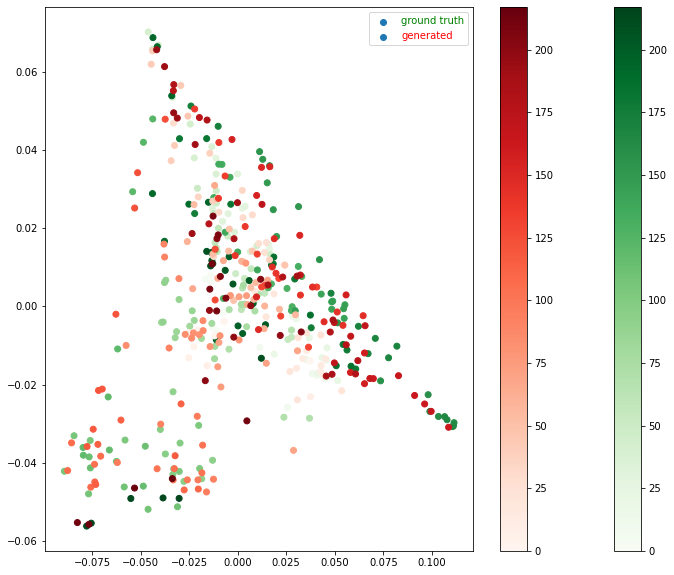

In [69]:
fig, ax = plt.subplots(figsize=(12,10))
real_plot = ax.scatter(Y_phate2_real[:,0], Y_phate2_real[:,1], c=list(range(Y_phate2_gen.shape[0])), 
                        cmap='Greens', vmin=0, vmax=Y_phate2_real.shape[0])
gen_plot = ax.scatter(Y_phate2_gen[:,0], Y_phate2_gen[:,1], c=list(range(Y_phate2_gen.shape[0])), 
                       cmap='Reds', vmin=0, vmax=Y_phate2_gen.shape[0])
plt.colorbar(real_plot)
plt.colorbar(gen_plot)
ax.legend([real_plot, gen_plot], ['ground truth', 'generated'], labelcolor=['green', 'red'])
plt.show()

In [70]:
phate_operator.set_params(n_components=3)
Y_phate3_3d = phate_operator.transform()

Y_phate3_real = Y_phate3_3d[:run_targets.shape[0],:]
Y_phate3_gen = Y_phate3_3d[run_targets.shape[0]:,:]

Calculating metric MDS...
Calculated metric MDS in 1.73 seconds.


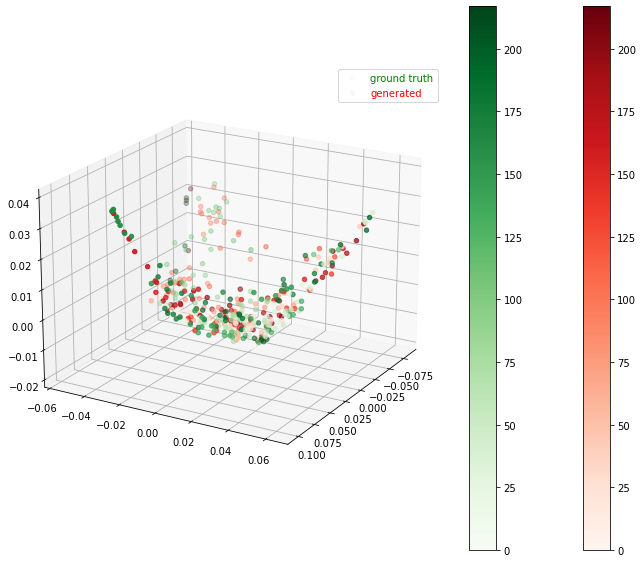

In [71]:
fig = plt.figure(figsize=(12,10))
ax = fig.add_subplot(111, projection='3d')


plot1_3d = ax.scatter(Y_phate3_real[:,0], Y_phate3_real[:,1], Y_phate3_real[:,2], 
                      c=list(range(Y_phate3_real.shape[0])), cmap='Greens', vmin=0, vmax=Y_phate3_real.shape[0])
plot2_3d = ax.scatter(Y_phate3_gen[:,0], Y_phate3_gen[:,1], Y_phate3_gen[:,2], 
                      c=list(range(Y_phate3_gen.shape[0])), cmap='Reds', vmin=0, vmax=Y_phate3_gen.shape[0])

ax.view_init(20, 30)

plt.colorbar(plot2_3d)
plt.colorbar(plot1_3d)
ax.legend([plot1_3d, plot2_3d], ['ground truth', 'generated'], labelcolor=['green', 'red'])
plt.show()

### All version embedded together

In [72]:
# all_p = np.concatenate((run_targets, pred_1, pred_2), axis=0)

# phate_operator = phate.PHATE()
# Y_phate2 = phate_operator.fit_transform(all_p)

# Y_phate2_real = Y_phate2[:run_targets.shape[0], :]
# Y_phate2_gen1 = Y_phate2[run_targets.shape[0]:run_targets.shape[0]+pred_1.shape[0], :]
# Y_phate2_gen2 = Y_phate2[run_targets.shape[0]+pred_1.shape[0]:, :]

In [73]:
# fig, ax = plt.subplots(figsize=(12,10))
# real_plot = ax.scatter(Y_phate2_real[:,0], Y_phate2_real[:,1], c=list(range(Y_phate2_gen.shape[0])), 
#                         cmap='Greens', vmin=0, vmax=Y_phate2_real.shape[0])
# gen_plot1 = ax.scatter(Y_phate2_gen1[:,0], Y_phate2_gen1[:,1], c=list(range(Y_phate2_gen1.shape[0])), 
#                        cmap='Reds', vmin=0, vmax=Y_phate2_gen1.shape[0])
# gen_plot2 = ax.scatter(Y_phate2_gen2[:,0], Y_phate2_gen2[:,1], c=list(range(Y_phate2_gen2.shape[0])), 
#                        cmap='Blues', vmin=0, vmax=Y_phate2_gen2.shape[0])

# plt.colorbar(real_plot)
# plt.colorbar(gen_plot1)
# plt.colorbar(gen_plot2)
# ax.legend([real_plot, gen_plot, gen_plot2], ['ground truth', 'generated 1', 'generated 2'], labelcolor=['green', 'red', 'blue'])
# plt.show()

In [74]:
# phate_operator.set_params(n_components=3)
# Y_phate3_3d = phate_operator.transform()

# Y_phate3_real = Y_phate3_3d[:run_targets.shape[0],:]
# Y_phate3_gen1 = Y_phate3_3d[run_targets.shape[0]:run_targets.shape[0]+pred_1.shape[0], :]
# Y_phate3_gen2 = Y_phate3_3d[run_targets.shape[0]+pred_1.shape[0]:, :]

In [75]:
# fig = plt.figure(1, figsize=(16,10))
# ax = fig.add_subplot(111, projection='3d')


# plot1_3d = ax.scatter(Y_phate3_real[:,0], Y_phate3_real[:,1], Y_phate3_real[:,2], 
#                       c=list(range(Y_phate3_real.shape[0])), cmap='Greens', vmin=0, vmax=Y_phate3_real.shape[0])
# plot2_3d = ax.scatter(Y_phate3_gen1[:,0], Y_phate3_gen1[:,1], Y_phate3_gen1[:,2], 
#                       c=list(range(Y_phate3_gen1.shape[0])), cmap='Reds', vmin=0, vmax=Y_phate3_gen1.shape[0])
# plot3_3d = ax.scatter(Y_phate3_gen2[:,0], Y_phate3_gen2[:,1], Y_phate3_gen2[:,2], 
#                       c=list(range(Y_phate3_gen2.shape[0])), cmap='Blues', vmin=0, vmax=Y_phate3_gen2.shape[0])

# ax.view_init(30, 30)

# plt.colorbar(plot3_3d)
# plt.colorbar(plot2_3d)
# plt.colorbar(plot1_3d)

# ax.legend([plot1_3d, plot2_3d, plot3_3d], ['ground truth', 'generated 1', 'generated 2'], labelcolor=['green', 'red', 'blue'])

### 3. Timeseries comparison

In [81]:
from IPython.display import clear_output

def display_timeseries_2D(Y_phate2_real, Y_phate2_gen1):
    
    for i in range(Y_phate2_real.shape[0]):

        clear_output(wait=True)

        fig, ax = plt.subplots(figsize=(12, 10))

        real_plot = ax.scatter(Y_phate2_real[:,0], Y_phate2_real[:,1], c=list(range(Y_phate2_gen.shape[0])), 
                            cmap='Greens', vmin=0, vmax=Y_phate2_real.shape[0])
        gen_plot1 = ax.scatter(Y_phate2_gen1[:,0], Y_phate2_gen1[:,1], c=list(range(Y_phate2_gen1.shape[0])), 
                           cmap='Reds', vmin=0, vmax=Y_phate2_gen1.shape[0])

        ax.plot([Y_phate2_real[i,0], Y_phate2_gen1[i,0]], [Y_phate2_real[i,1], Y_phate2_gen1[i,1]], color='cyan', lw='5.0')
        ax.plot(Y_phate2_real[i,0], Y_phate2_real[i,1], marker='o', mec='cyan', color='green', ms='12')
        ax.plot(Y_phate2_gen1[i,0], Y_phate2_gen1[i,1], marker='o', mec='cyan', color='red', ms='12')
        plt.title(f'Timepoint {i}')
    #     plt.show()

        fig.savefig(f"./gan_results/pca_t{i}")
        
def display_timeseries_3D(Y_phate3_real, Y_phate3_gen): 

    for i in range(Y_phate3_real.shape[0]):

        fig = plt.figure(figsize=(12,10))
        ax = fig.add_subplot(111, projection='3d')

        plot1_3d = ax.scatter(Y_phate3_real[:,0], Y_phate3_real[:,1], Y_phate3_real[:,2], c=list(range(Y_phate3_real.shape[0])), 
                          cmap='Greens', vmin=0, vmax=Y_phate3_real.shape[0])
        plot2_3d = ax.scatter(Y_phate3_gen[:,0], Y_phate3_gen[:,1], Y_phate3_gen[:,2], c=list(range(Y_phate3_gen.shape[0])), 
                          cmap='Reds', vmin=0, vmax=Y_phate3_gen.shape[0])

        ax.plot([Y_phate3_real[i,0], Y_phate3_gen[i,0]], [Y_phate3_real[i,1], Y_phate3_gen[i,1]], [Y_phate3_real[i,2], Y_phate3_gen[i,2]], color='cyan', lw='5.0')
        ax.plot(Y_phate3_real[i,0], Y_phate3_real[i,1], Y_phate3_real[i,2], marker='o', mec='cyan', color='green', ms='12')
        ax.plot(Y_phate3_gen[i,0], Y_phate3_gen[i,1], Y_phate3_gen[i,2], marker='o', mec='cyan', color='red', ms='12')

        plt.title(f'Timepoint {i}')
        ax.view_init(20, 30)

        ax.legend([plot1_3d, plot2_3d], ['ground truth', 'generated samples'], labelcolor=['green', 'red'])
        fig.savefig(f"./gan_results/pca_3d_t{i}")

In [82]:
run_all = np.concatenate((run_targets, pred_1))

phate_operator = phate.PHATE()
Y_phate_series = phate_operator.fit_transform(run_all)

Calculating PHATE...
  Running PHATE on 434 observations and 50 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 0.01 seconds.
    Calculating affinities...
  Calculated graph and diffusion operator in 0.03 seconds.
  Calculating optimal t...
    Automatically selected t = 22
  Calculated optimal t in 0.36 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.34 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.25 seconds.
Calculated PHATE in 1.00 seconds.


In [83]:
t_run = run_targets.shape[0]
phate_real = Y_phate_series[:t_run, :]
phate_pred = Y_phate_series[t_run:, :]

print(phate_real.shape)
print(phate_pred.shape)

(217, 2)
(217, 2)


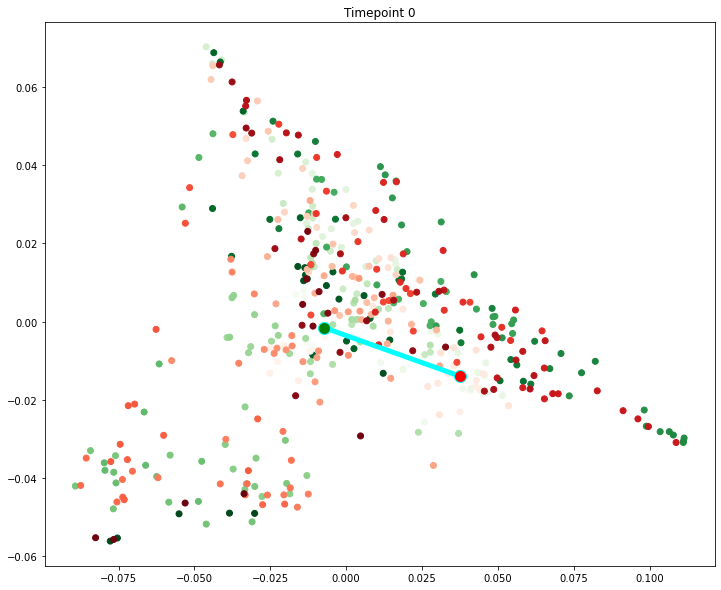

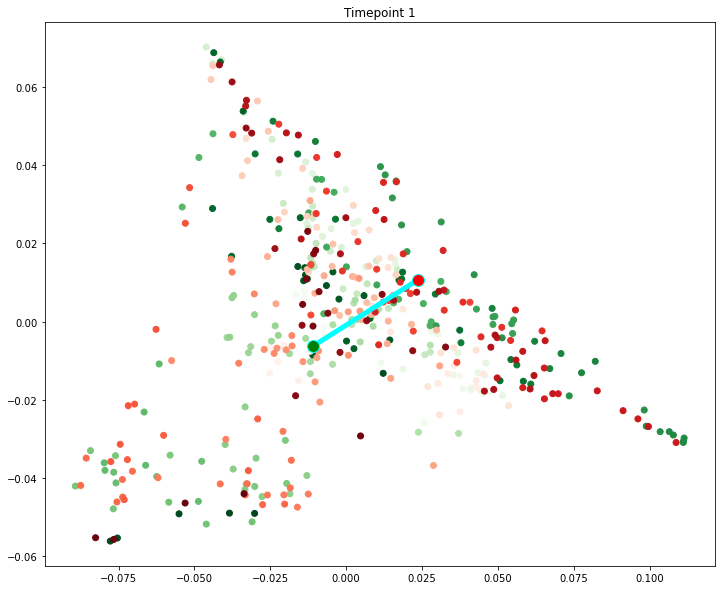

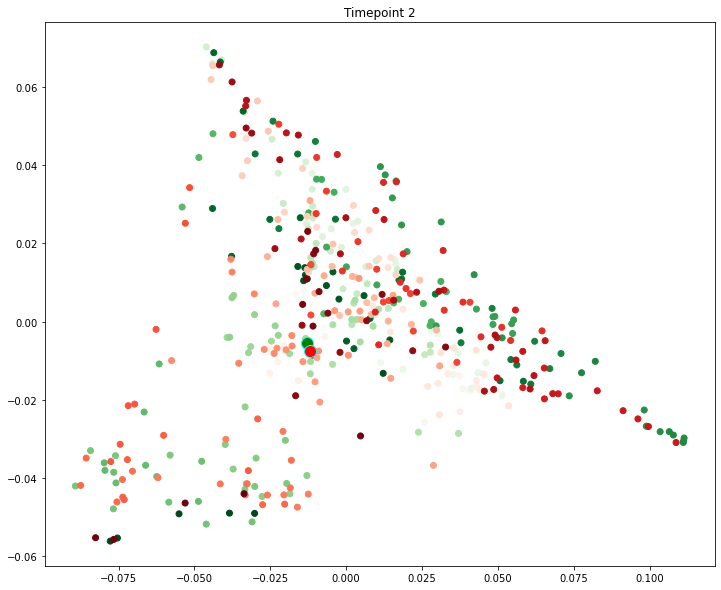

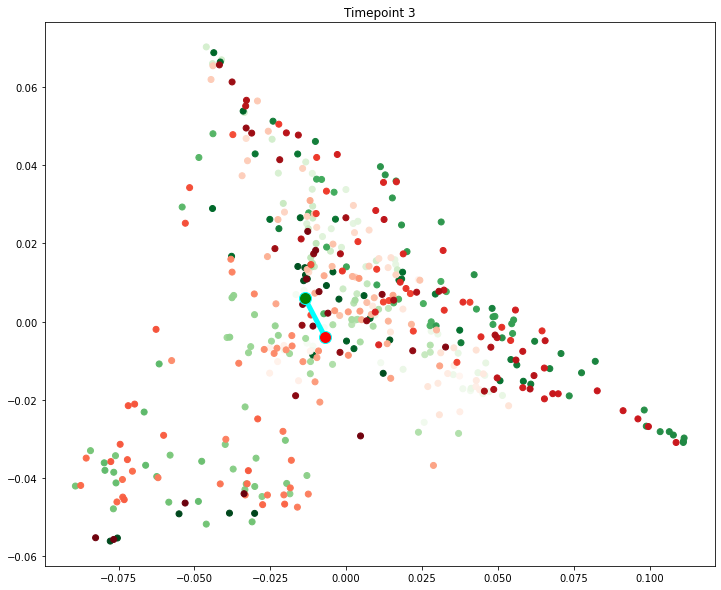

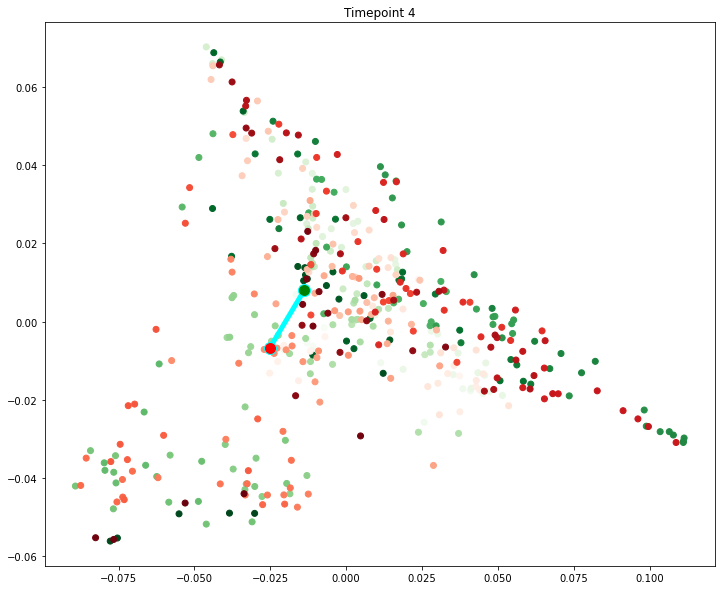

...

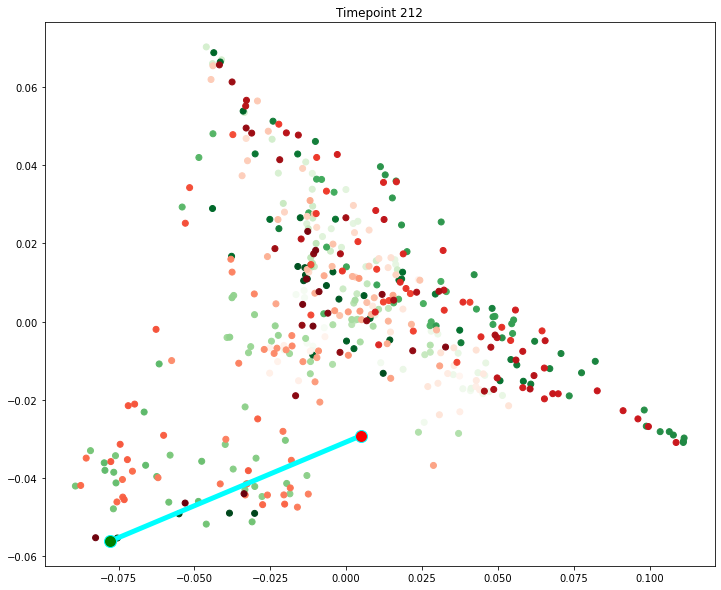

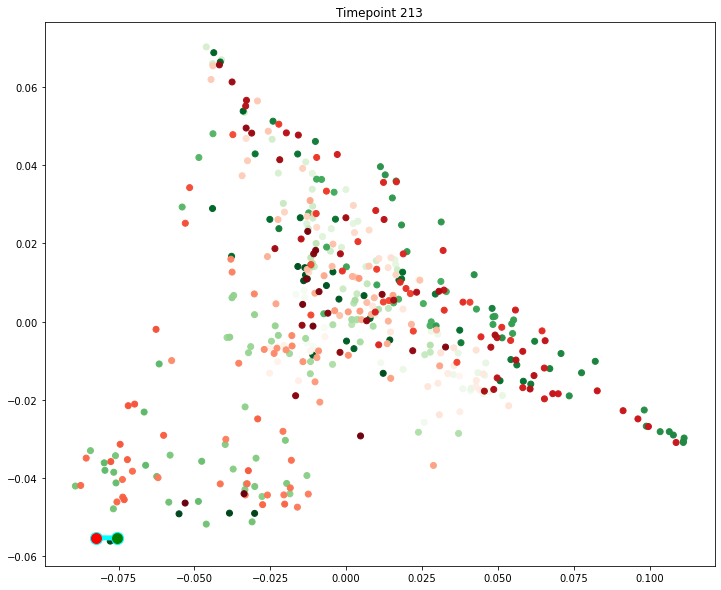

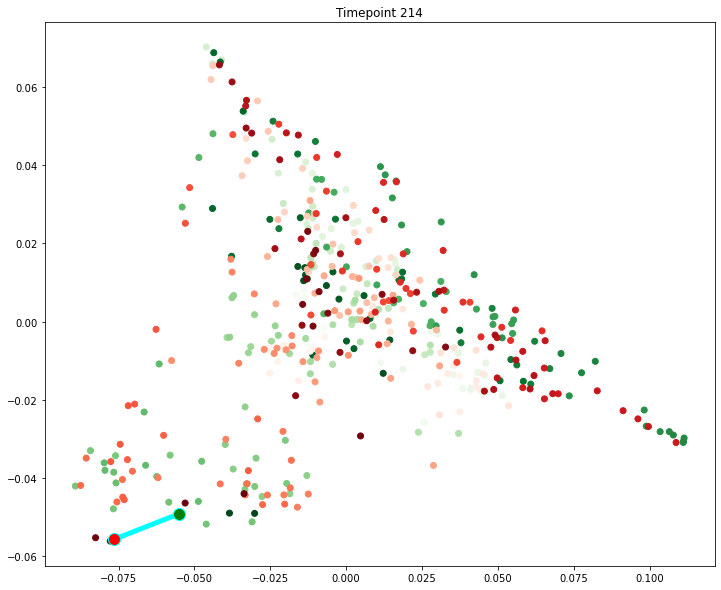

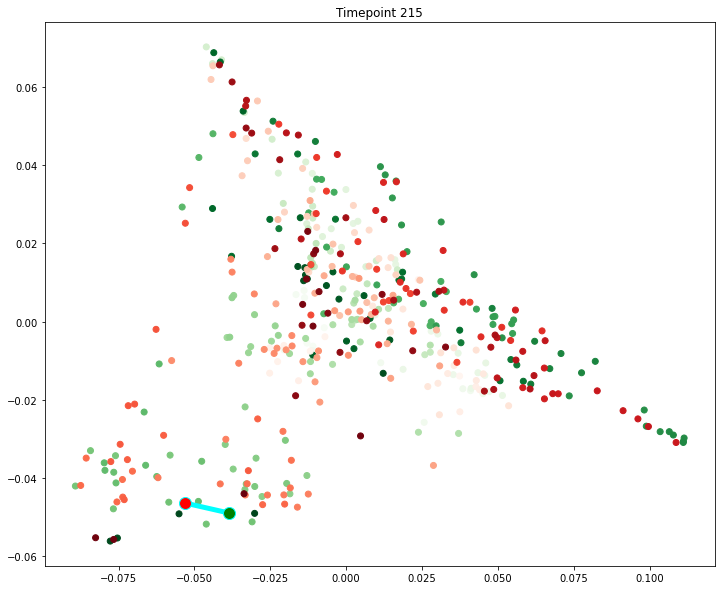

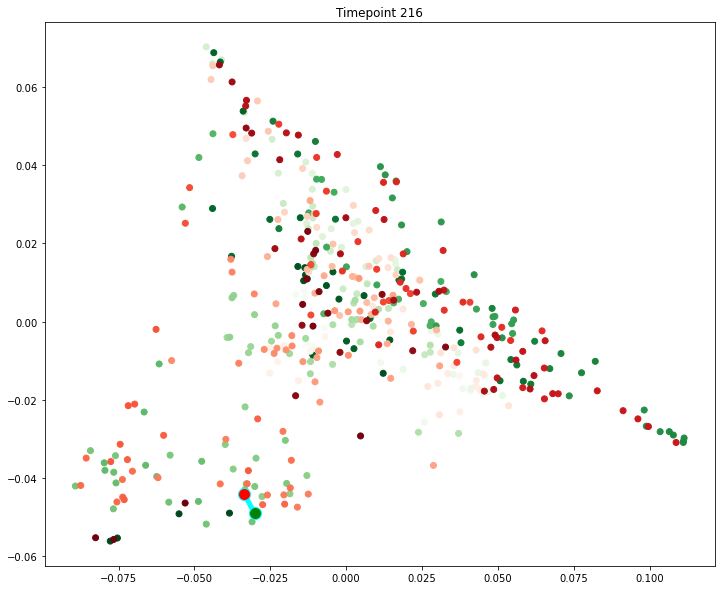

In [84]:
display_timeseries_2D(phate_real, phate_pred)

In [85]:
phate_operator.set_params(n_components=3)
Y_phate_series_3d = phate_operator.transform()

phate_real_3d = Y_phate3_3d[:t_run, :]
phate_pred_3d = Y_phate3_3d[t_run:2*t_run, :]

print(phate_real_3d.shape)
print(phate_pred_3d.shape)

Calculating metric MDS...
Calculated metric MDS in 4.79 seconds.
(217, 3)
(217, 3)


<ipython-input-81-6c6cec2a8fbb>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12,10))


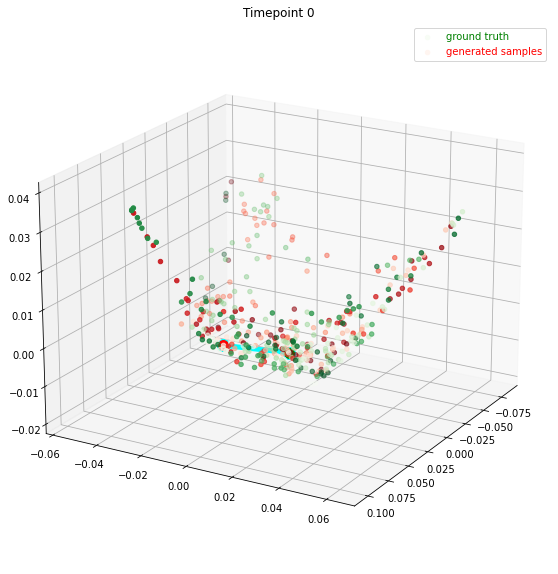

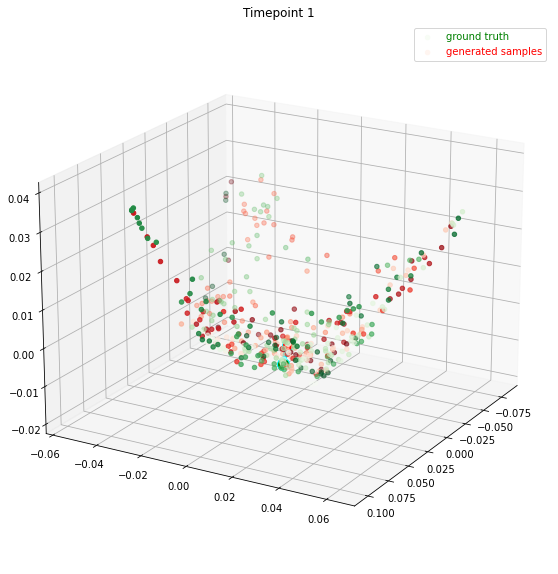

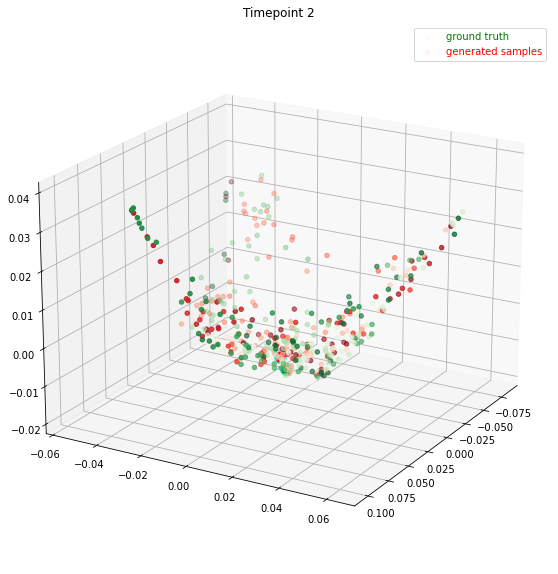

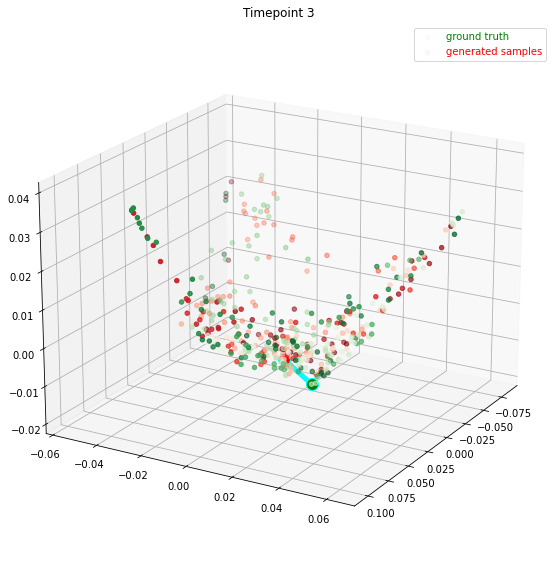

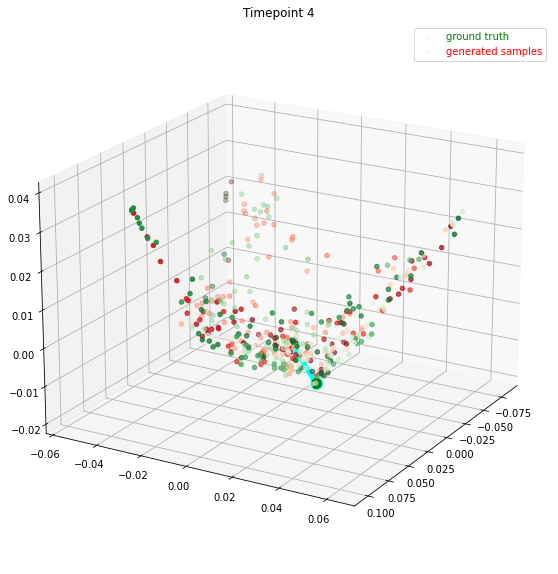

...

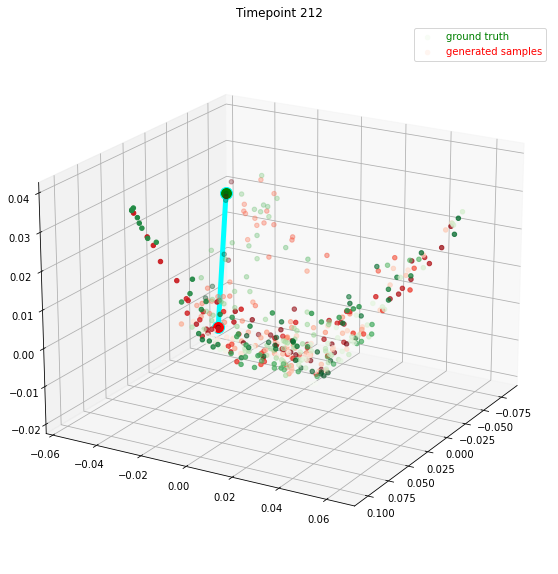

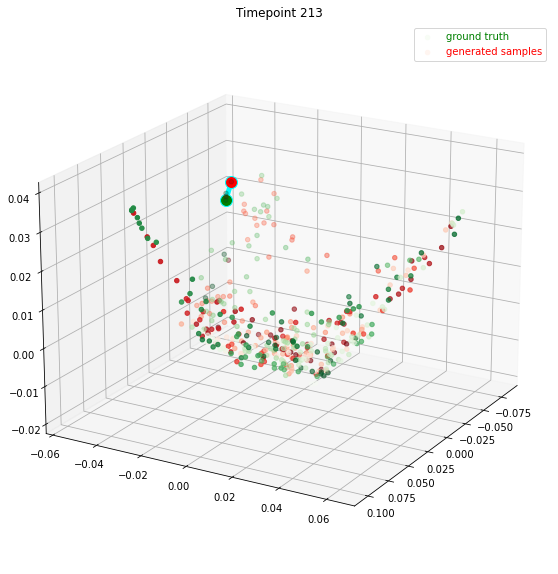

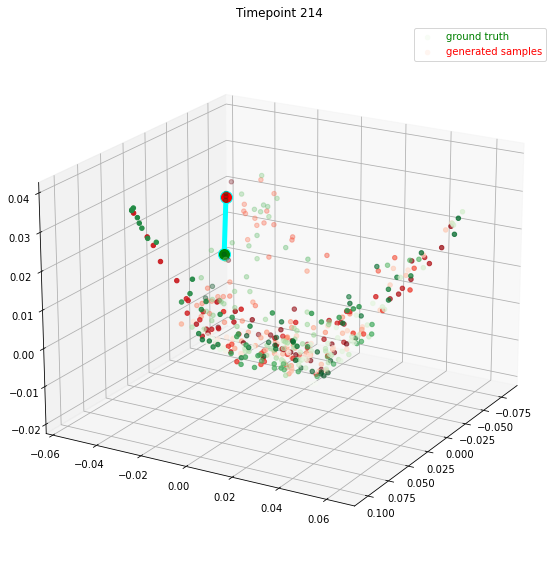

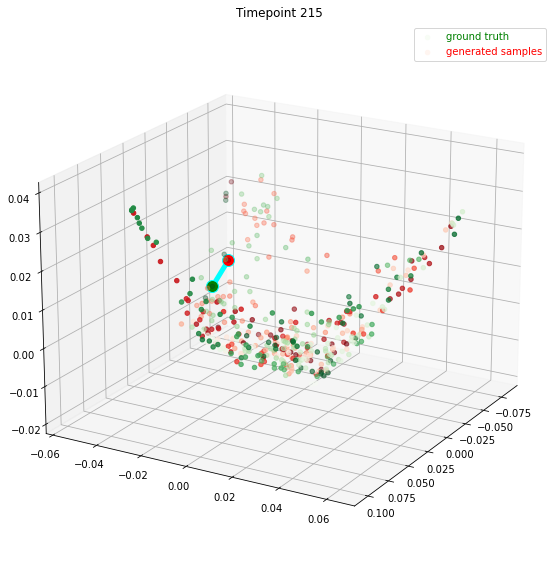

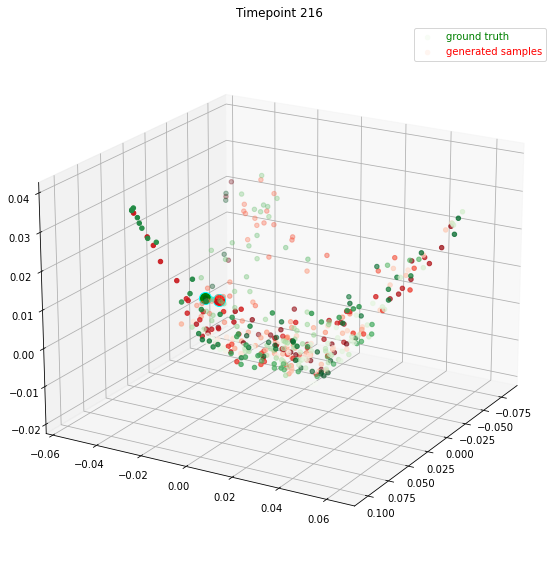

In [86]:
display_timeseries_3D(phate_real_3d, phate_pred_3d)